In [73]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import timeit

img_left_rgb = cv2.imread("./data/left.jpg")
img_left_gray = cv2.cvtColor(img_left_rgb, cv2.COLOR_BGR2GRAY)
img_right_rgb = cv2.imread("./data/right.jpg")
img_right_gray = cv2.cvtColor(img_right_rgb, cv2.COLOR_BGR2GRAY)
img_left_rgb = cv2.cvtColor(img_left_rgb, cv2.COLOR_BGR2RGB)
img_right_rgb = cv2.cvtColor(img_right_rgb, cv2.COLOR_BGR2RGB)


In [74]:
start = timeit.default_timer()


In [75]:
sift = cv2.SIFT_create(nfeatures=20000)
kp_l, des_l = sift.detectAndCompute(img_left_gray, None)
kp_r, des_r = sift.detectAndCompute(img_right_gray, None)


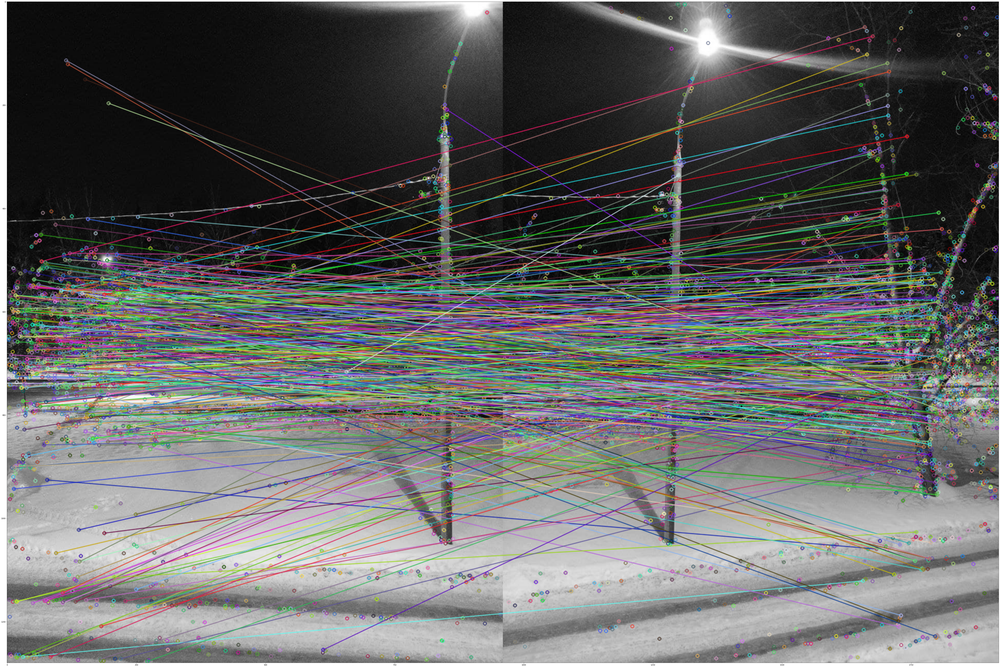

In [76]:
flann = cv2.FlannBasedMatcher_create()
matches = flann.knnMatch(des_r, des_l, k=2)
good = []
dist_ratio = 0.75
for m, n in matches:
    if m.distance < dist_ratio * n.distance:
        good.append([m])
matches = np.asarray(good)
matching_result = cv2.drawMatchesKnn(
    img_left_gray, kp_l, img_right_gray, kp_r, good, None
)
start_fig = timeit.default_timer()
plt.figure(figsize=(100, 100))
plt.imshow(matching_result)
plt.show()
stop_fig = timeit.default_timer()


In [77]:
if len(matches[:, 0]) < 4:
    raise AssertionError("Homography is not available. Number of keypoints lessthan 4")
left = np.float32([kp_r[m.queryIdx].pt for m in matches[:, 0]]).reshape(-1, 1, 2)
right = np.float32([kp_l[m.trainIdx].pt for m in matches[:, 0]]).reshape(-1, 1, 2)
H, mask = cv2.findHomography(left, right, cv2.RANSAC, 5.0)


In [78]:
img_result = cv2.warpPerspective(
    img_right_rgb,
    H,
    (img_right_rgb.shape[1] + img_left_rgb.shape[1], img_left_rgb.shape[0]),
)
img_result[0 : img_left_rgb.shape[0], 0 : img_left_rgb.shape[1]] = img_left_rgb


In [79]:
stop = timeit.default_timer()
print("Computing time:", stop - start - (stop_fig - start_fig), "seconds.")


Computing time: 2.023689299938269 seconds.


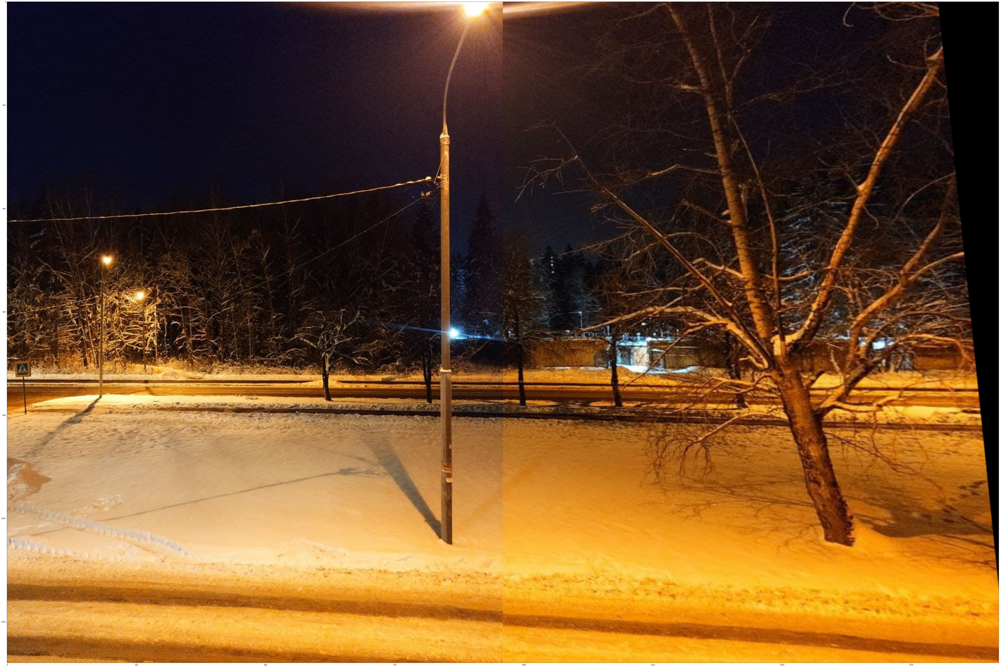

In [80]:
plt.figure(figsize=(100, 100))
plt.imshow(img_result)
plt.show()
